## Imports and Setup

In [ ]:
#!git clone https://github.com/GFDRR/disaster-fcv-colocation-mapping.git
#%cd disaster-fcv-colocation-mapping
#!apt-get update && apt-get install -y --no-install-recommends gdal-bin
#!pip install -r requirements.txt

In [ ]:
#%cd disaster-fcv-colocation-mapping
#%ls

In [1]:
from src.dfcv_colocation_mapping import data_download
from src.dfcv_colocation_mapping import data_utils
from src.dfcv_colocation_mapping import map_utils

import pandas as pd
pd.set_option('display.max_columns', None)
pd.set_option('display.width', 1000)

%load_ext autoreload
%autoreload 2

## Parameters

In [2]:
iso_code = "MMR"
adm_level = "ADM3"
acled_start_date = "2021-01-01"

## Download Datasets

In [ ]:
dm = data_download.DatasetManager(
    iso_code, 
    adm_level=adm_level,
    acled_start_date=acled_start_date,
    mhs_aggregation="power_mean"
)
geoplot = map_utils.GeoPlot(dm)
dm.data.sort_values("mhs_dfcv_conflict_exposure_relative", ascending=False).head(3)

## AHP Weight Calculation [Optional]

In [90]:
dm.calculate_ahp()
geoplot = map_utils.GeoPlot(dm)
dm.data.sort_values("mhs_dfcv_conflict_exposure_relative", ascending=False).head(3)

How much more important is earthquake compared to landslide:  9
How much more important is earthquake compared to cyclone:  9
How much more important is earthquake compared to pluvial_defended:  9
How much more important is earthquake compared to fluvial_defended:  9
How much more important is earthquake compared to coastal_defended:  9
How much more important is landslide compared to cyclone:  1
How much more important is landslide compared to pluvial_defended:  1
How much more important is landslide compared to fluvial_defended:  1
How much more important is landslide compared to coastal_defended:  1
How much more important is cyclone compared to pluvial_defended:  1
How much more important is cyclone compared to fluvial_defended:  1
How much more important is cyclone compared to coastal_defended:  1
How much more important is pluvial_defended compared to fluvial_defended:  1
How much more important is pluvial_defended compared to coastal_defended:  1
How much more important is fluvi

INFO:root:Consistency_ratio: 0.0
INFO:root:{'earthquake': 0.64286, 'landslide': 0.07143, 'cyclone': 0.07143, 'pluvial_defended': 0.07143, 'fluvial_defended': 0.07143, 'coastal_defended': 0.07143}


,iso_code,ADM3,ADM3_ID,ADM2_ID,ADM2,ADM1_ID,ADM1,worldpop,earthquake,earthquake_exposure,earthquake_intensity_weighted_exposure,landslide,landslide_exposure,landslide_intensity_weighted_exposure,cyclone,cyclone_exposure,cyclone_intensity_weighted_exposure,geometry,coastal_defended,coastal_defended_exposure,coastal_defended_intensity_weighted_exposure,fluvial_defended,fluvial_defended_exposure,fluvial_defended_intensity_weighted_exposure,pluvial_defended,pluvial_defended_exposure,pluvial_defended_intensity_weighted_exposure,population_best,conflict_count,null_conflict_count,acled_conflict_exposure,dfcv_conflict_exposure,earthquake_exposure_relative,earthquake_intensity_weighted_exposure_relative,landslide_exposure_relative,landslide_intensity_weighted_exposure_relative,cyclone_exposure_relative,cyclone_intensity_weighted_exposure_relative,coastal_defended_exposure_relative,coastal_defended_intensity_weighted_exposure_relative,fluvial_defended_exposure_relative,fluvial_defended_intensity_weighted_exposure_relative,pluvial_defended_exposure_relative,pluvial_defended_intensity_weighted_exposure_relative,acled_conflict_exposure_relative,dfcv_conflict_exposure_relative,mhs_exposure_relative,mhs_dfcv_conflict_exposure_relative,mhs_intensity_weighted_exposure_relative,BLOC
130,MMR,Hlaingtharya,66882298B54341055682393,60261553B66884558345744,Yangon (North),20573499B24734669936209,Yangon,851881.25000,0.217054,851881.25000,163153.062500,1.000000,0.000000,0.000000,116.517555,851881.25000,583657.37500,"POLYGON ((96.07177 16.92943, 96.0679 16.93314,...",0.270933,608804.3125,84966.156250,0.352682,590565.375000,65370.761719,0.000617,800.041504,51.375126,56324317.0,330.0,68.0,214978.309160,851830.37500,1.0,0.191521,0.000000,0.000000,1.0,0.685139,0.714659,0.099739,0.693248,0.076737,0.000939,0.000060,0.252357,0.999940,1.000000,0.999940,0.421570,Lower Myanmar
86,MMR,Shwepyithar,66882298B81098727977819,60261553B66884558345744,Yangon (North),20573499B24734669936209,Yangon,429312.37500,0.225473,429312.37500,84734.929688,1.000000,0.000000,0.000000,116.517555,429312.37500,288927.75000,"POLYGON ((96.10831 16.93481, 96.1092 16.93603,...",0.127717,136098.3750,14942.892578,0.274515,254060.359375,24633.687500,0.003960,6487.383789,430.536652,18999753.0,232.0,53.0,106143.871508,429312.37500,1.0,0.197374,0.000000,0.000000,1.0,0.673001,0.317015,0.034807,0.591784,0.057379,0.015111,0.001003,0.247242,1.000000,0.957061,0.957061,0.407432,Lower Myanmar
230,MMR,Amarapura,66882298B63555975911592,60261553B2723221956862,Mandalay,20573499B45980987355836,Mandalay,249937.40625,0.355947,249937.40625,81699.078125,2.101538,50206.699219,37655.023438,96.283745,249937.40625,142530.15625,"POLYGON ((96.04233 21.941, 96.03628 21.93495, ...",0.000000,0.0000,0.000000,0.270039,149562.312500,45666.027344,0.005017,2401.314697,168.435562,3275163.0,158.0,37.0,27067.462810,246869.21875,1.0,0.326878,0.200877,0.150658,1.0,0.570263,0.000000,0.000000,0.598399,0.182710,0.009608,0.000674,0.108297,0.987724,0.934491,0.922911,0.666099,Dry zone


# Publication-ready Maps

## Plot Regional Groupings

In [ ]:
geoplot.plot_geoboundaries(
    adm_level="ADM1", 
    group="BLOC",
    title="Myanmar Regional Groupings",
    annotation="Regional groupings: The World Bank Group"
);

## Plot Population

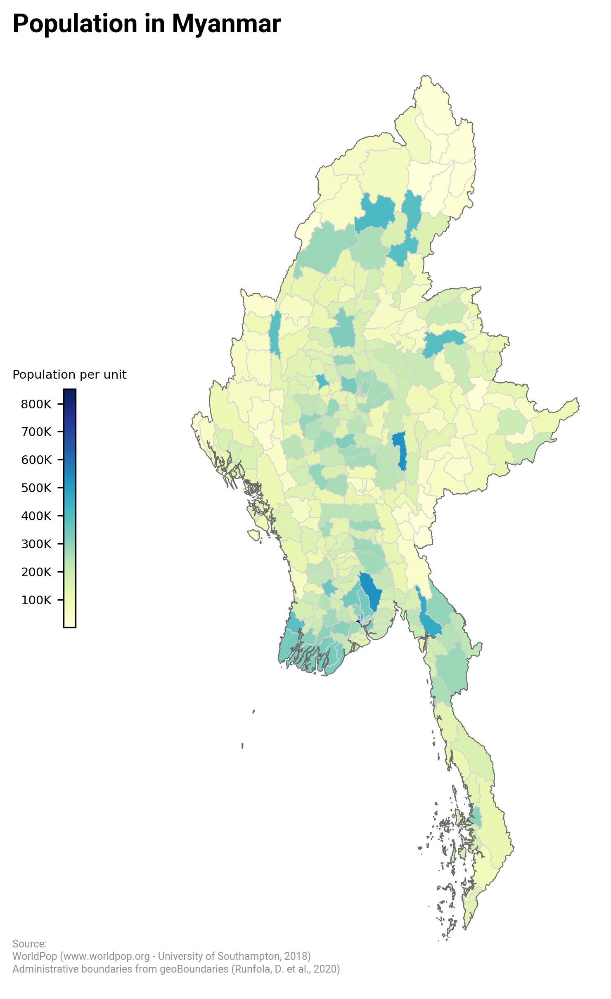

In [9]:
ax = geoplot.plot_choropleth( 
    var="worldpop",
    update_config={"legend_type": "colorbar"}
)

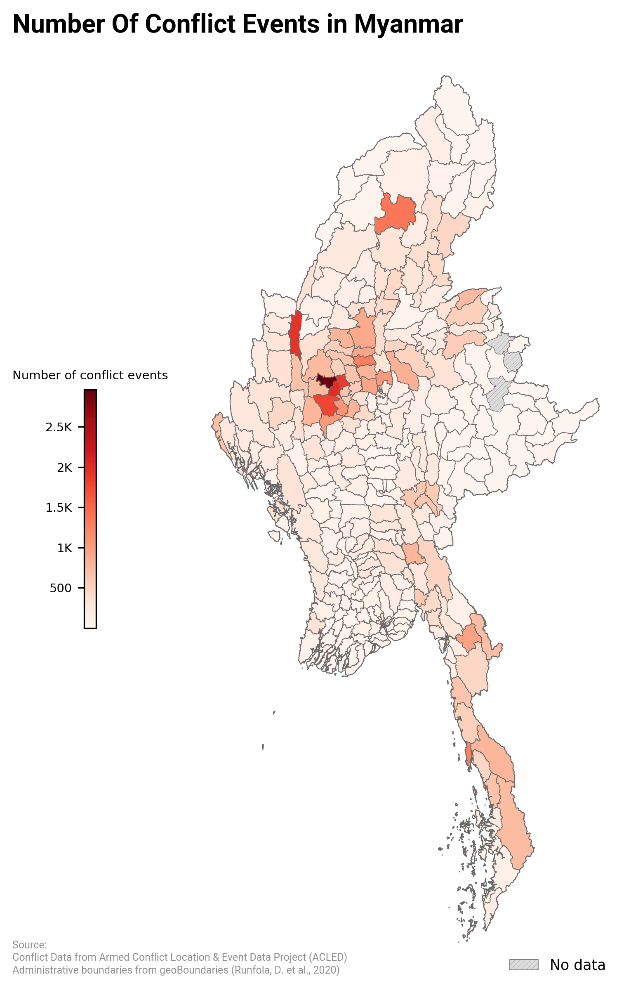

In [10]:
geoplot.plot_choropleth( 
    var="conflict_count",
    update_config={
        "legend_type": "colorbar",
        "palette_name": "Reds",
        "edgecolor": "dimgray"
    }
);

## Plot Conflict Exposure - ACLED

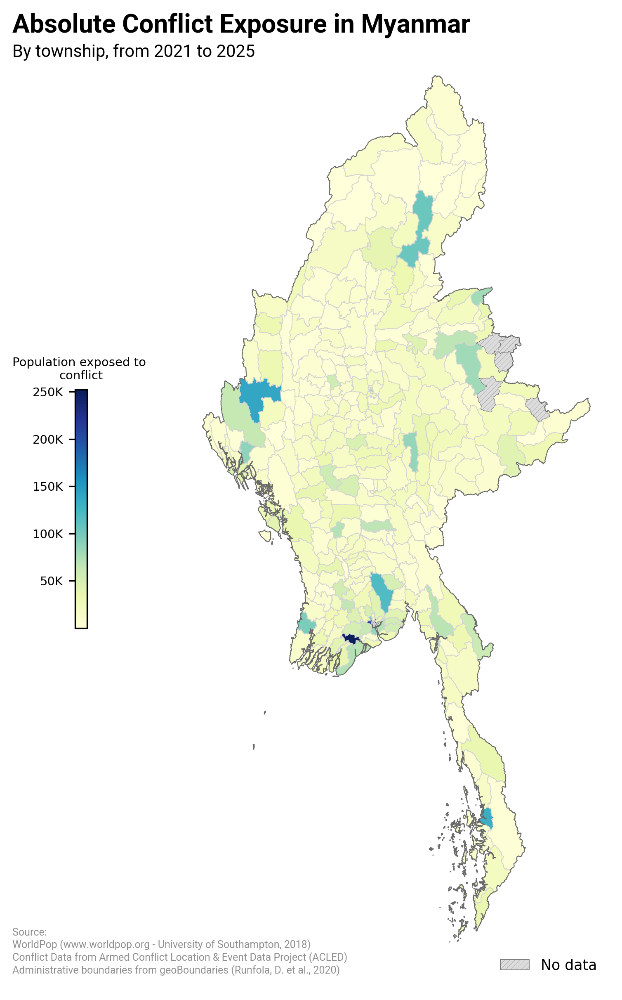

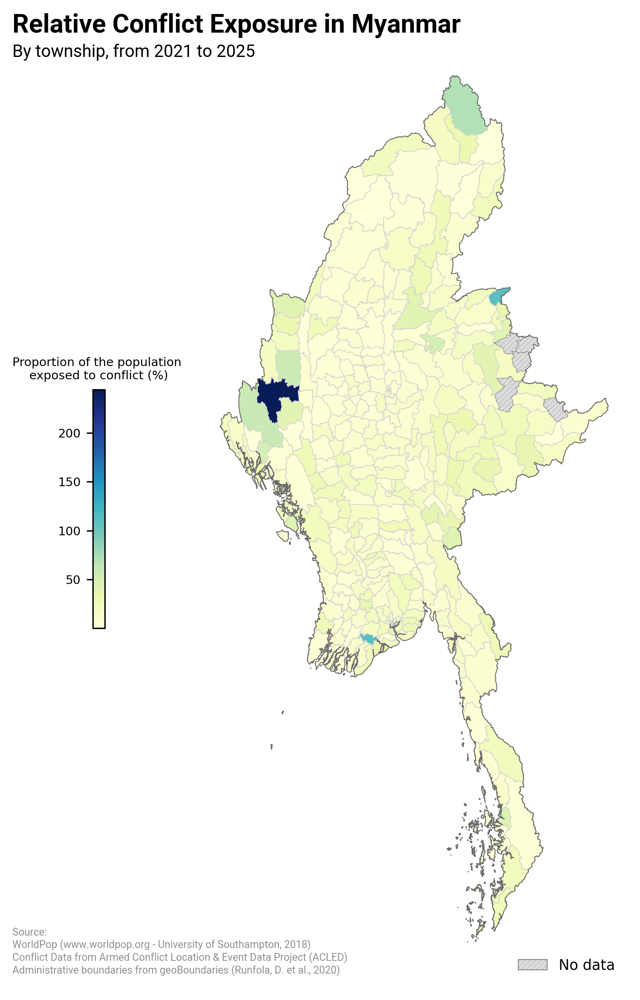

In [11]:
source = "acled"
geoplot.plot_choropleth( 
    var=f"{source}_conflict_exposure",
    subtitle="By township, from 2021 to 2025",
    update_config={"legend_type": "colorbar"}
)
geoplot.plot_choropleth( 
    var=f"{source}_conflict_exposure_relative",
    subtitle="By township, from 2021 to 2025",
    update_config={"legend_type": "colorbar"}
);

## Plot Conflict Exposure - World Bank

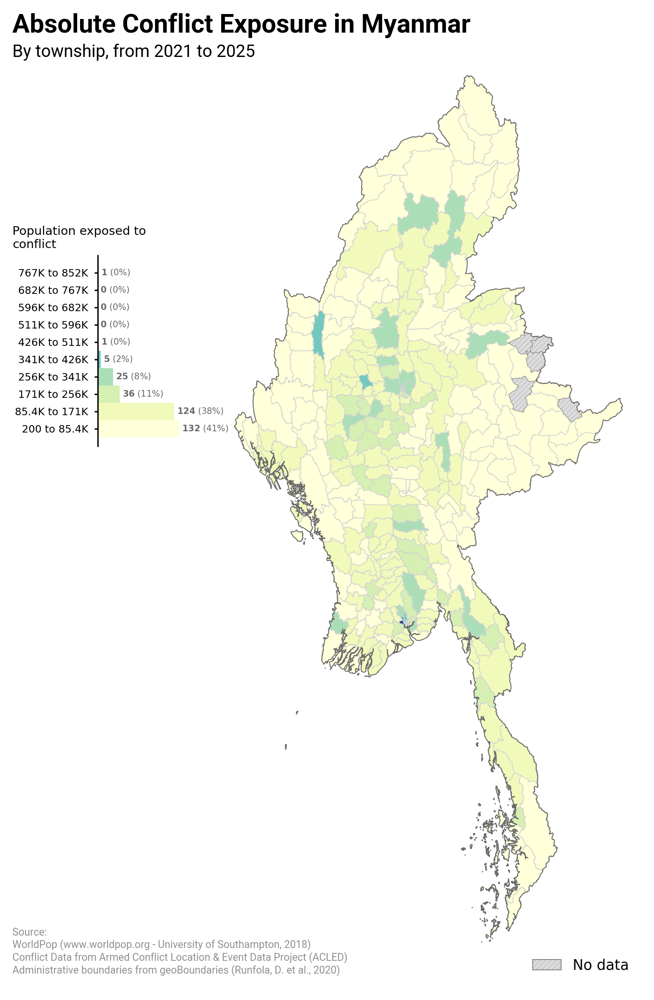

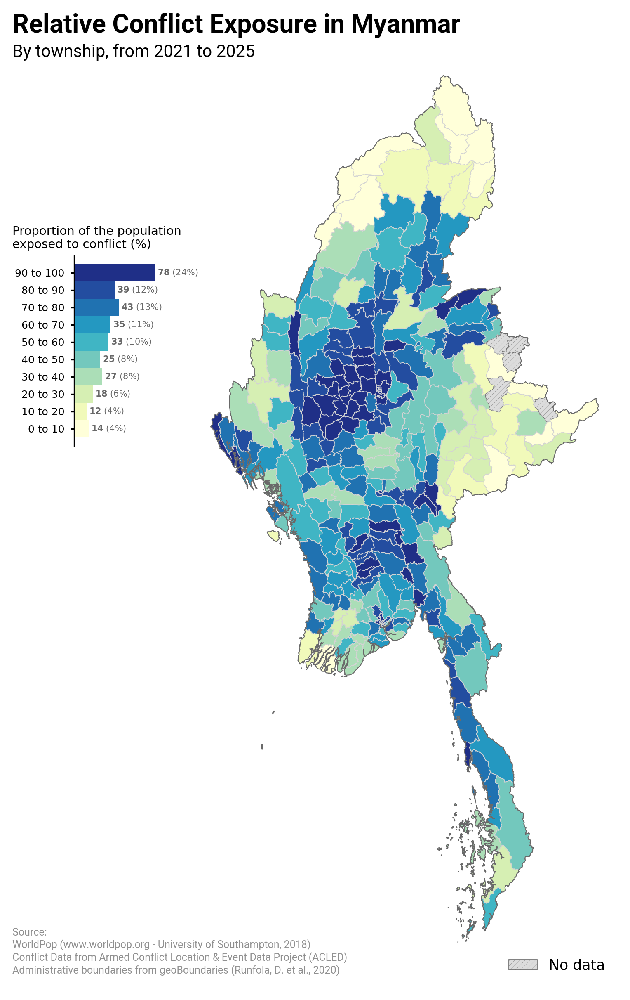

In [12]:
source = "dfcv"
geoplot.plot_choropleth( 
    var=f"{source}_conflict_exposure",
    subtitle="By township, from 2021 to 2025"
)
geoplot.plot_choropleth( 
    var=f"{source}_conflict_exposure_relative",
    var_bounds=[0, 100],
    subtitle="By township, from 2021 to 2025"
);

## Zoom Choropleth to a specific region

In [ ]:
source = "dfcv"
geoplot.plot_choropleth( 
    var=f"{source}_conflict_exposure",
    zoom_to={"ADM1": "Kigali City"},
    subtitle="By township, from 2021 to 2025"
)
geoplot.plot_choropleth( 
    var=f"{source}_conflict_exposure_relative",
    zoom_to={"ADM1": "Kigali City"},
    subtitle="By township, from 2021 to 2025",
    var_bounds=[0, 100]
)

## Map Exposure to a Single Hazard

C:\Users\Isabelle\Documents\GFDRR\dfcv\colocation-mapping\utils\map_utils.py:173: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  cbar.ax.set_yticklabels(cbar.ax.get_yticklabels(), fontsize=config["cbar_fontsize"])


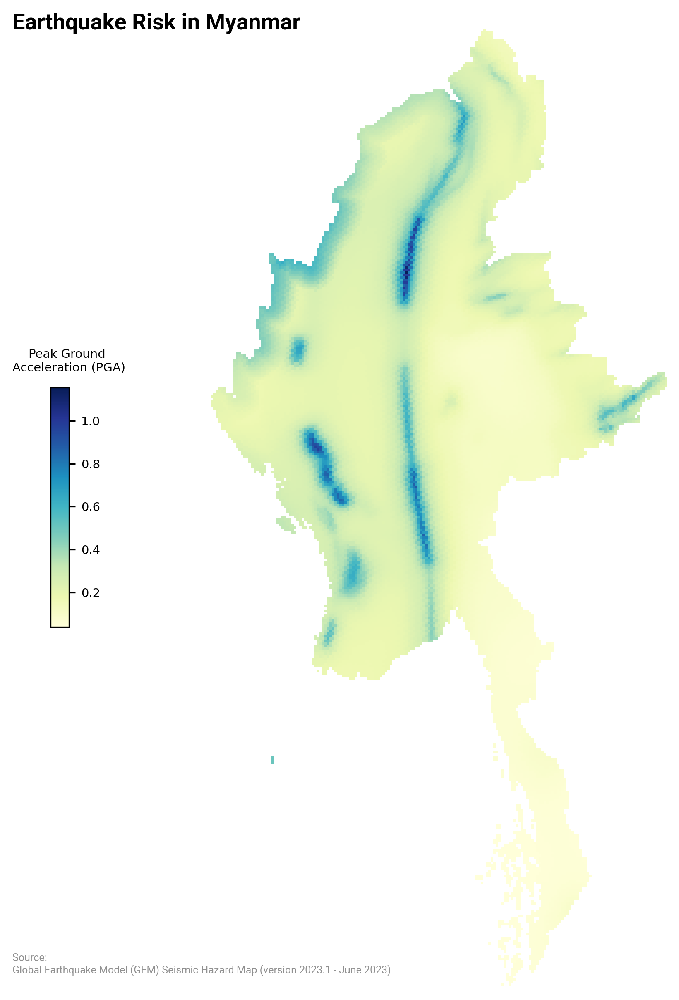

In [13]:
hazard = "earthquake"
geoplot.plot_raster(hazard);

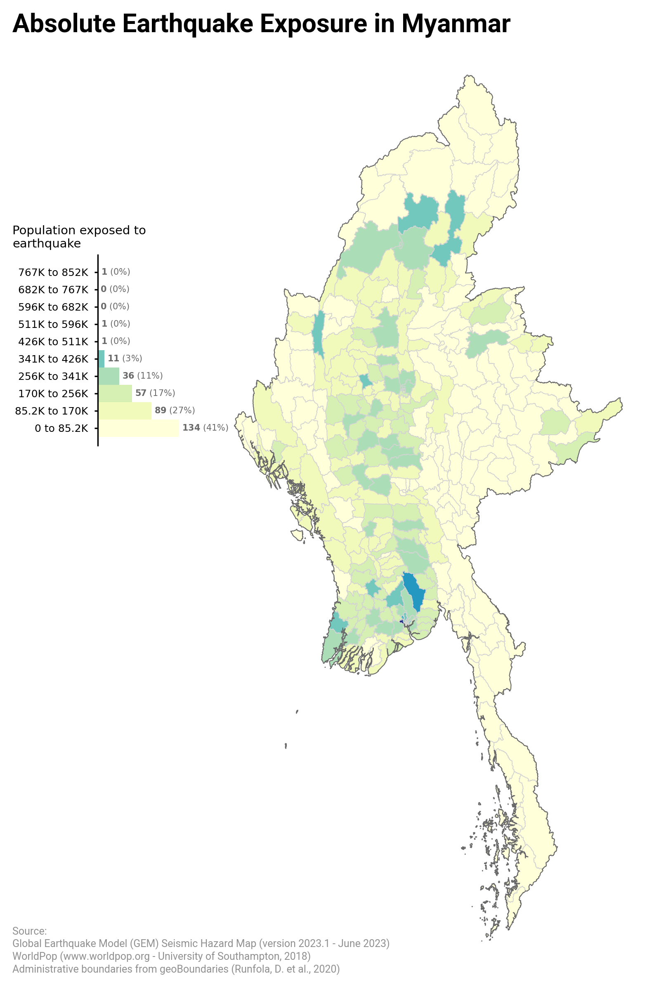

In [14]:
geoplot.plot_choropleth(f"{hazard}_exposure");

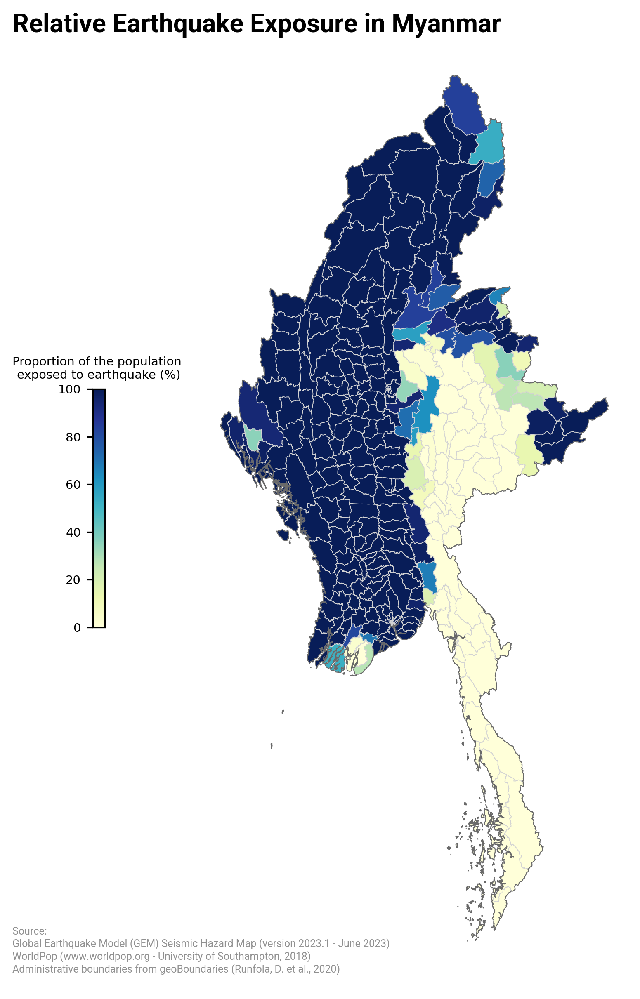

In [15]:
geoplot.plot_choropleth(
    f"{hazard}_exposure_relative",
    update_config={
        "legend_type": "colorbar",
    }
);

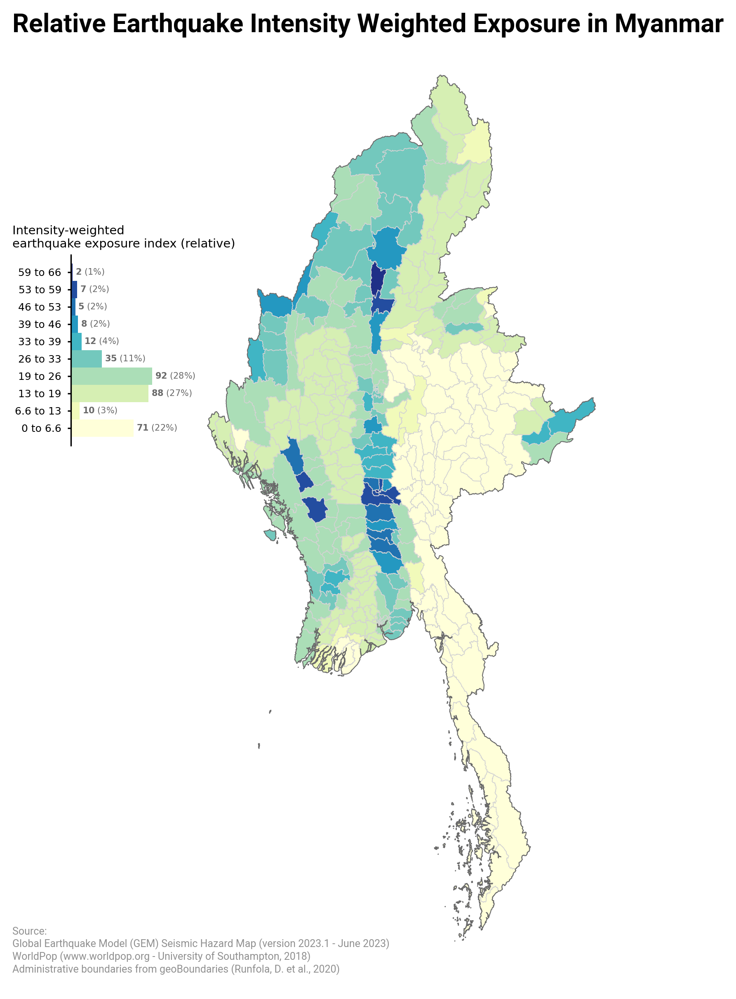

In [98]:
geoplot.plot_choropleth(
    f"{hazard}_intensity_weighted_exposure_relative",
    #update_config={
    #    "legend_type": "colorbar",
    #}
);

## Plot Multi-hazard Exposure Index and Multi-hazard Conflict Exposure Index

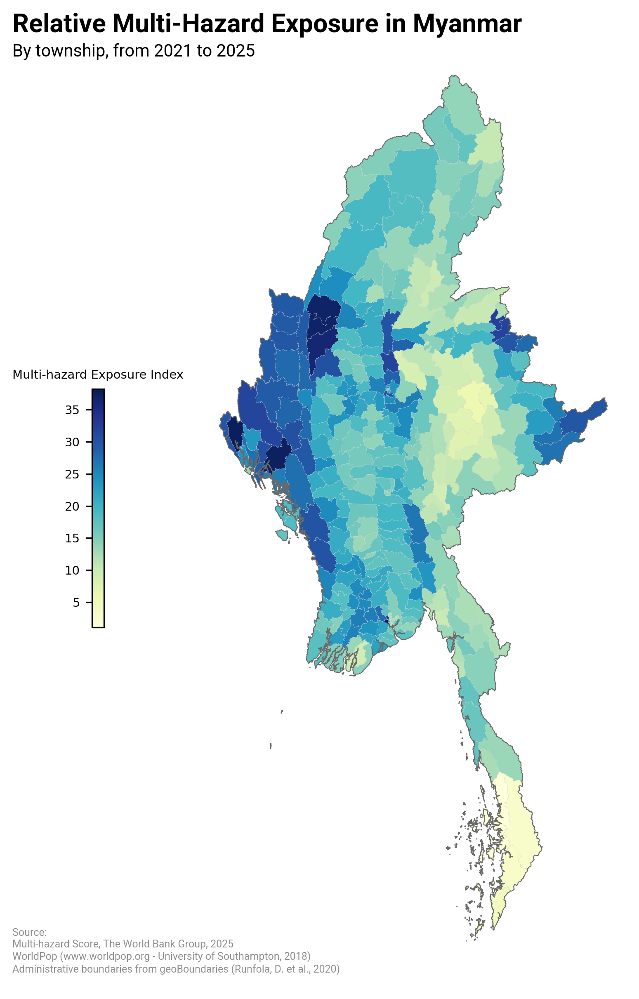

In [94]:
geoplot.plot_choropleth( 
    var="mhs_exposure_relative",
    subtitle="By township, from 2021 to 2025",
    update_config={
        "legend_type": "colorbar", 
        "linewidth": 0.1
    }
);

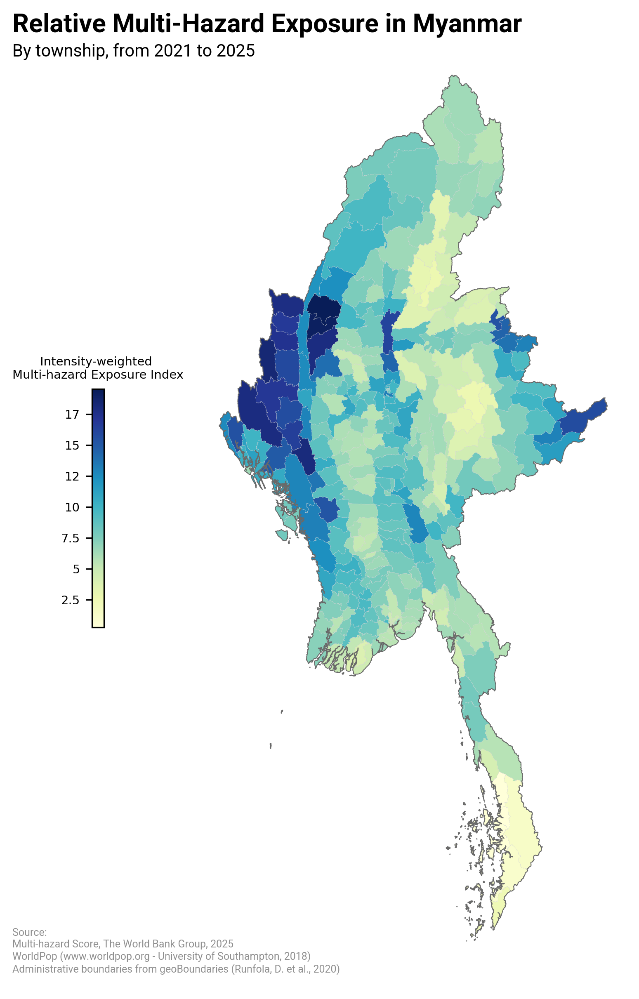

In [96]:
geoplot.plot_choropleth( 
    var="mhs_intensity_weighted_exposure_relative",
    subtitle="By township, from 2021 to 2025",
    update_config={
        "legend_type": "colorbar", 
        "linewidth": 0.1
    }
);

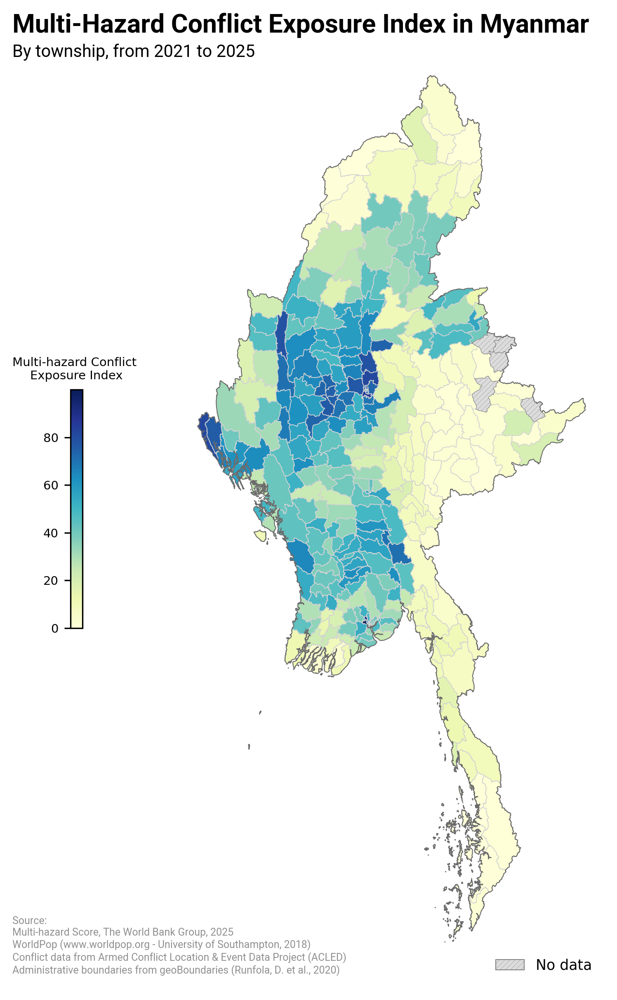

In [83]:
geoplot.plot_choropleth( 
    var="mhs_dfcv_conflict_exposure_relative",
    subtitle="By township, from 2021 to 2025",
    update_config={"legend_type": "colorbar"}
);

# Bivariate Choropleth: Overlay Multi-hazard and Conflict Exposure

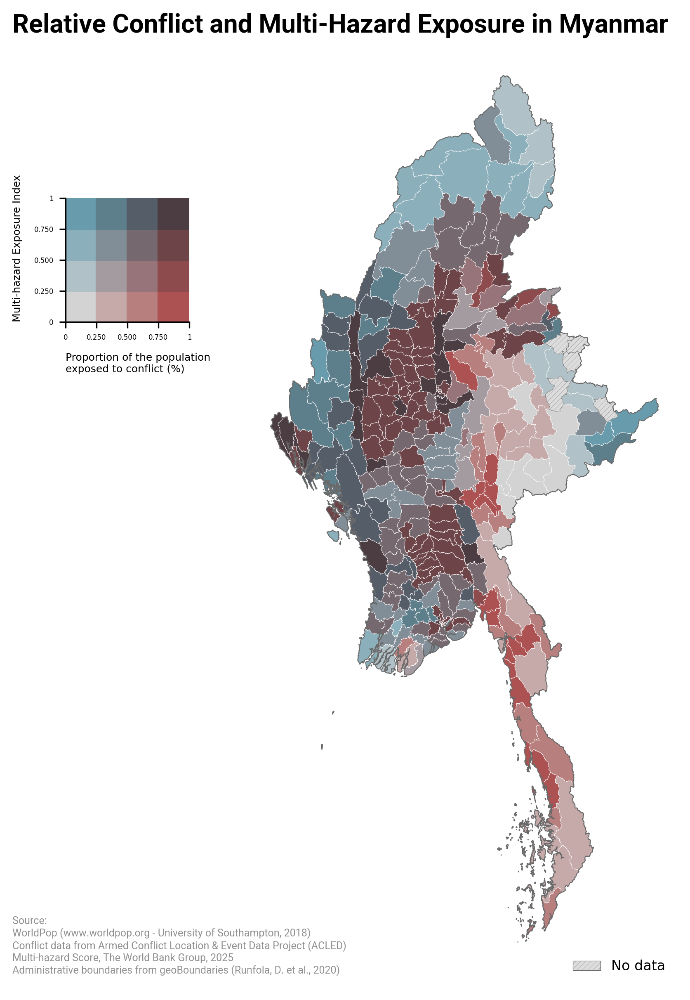

In [86]:
geoplot.plot_bivariate_choropleth( 
    var1="dfcv_conflict_exposure_relative",
    var2="mhs_exposure_relative",
    var1_bounds=[0, 1],
    var2_bounds=[0, 1],
    binning="equal_intervals",
    update_config={
        "legend_fontsize": 4, 
        "edgecolor": "white", 
        "linewidth": 0.2
    }
);

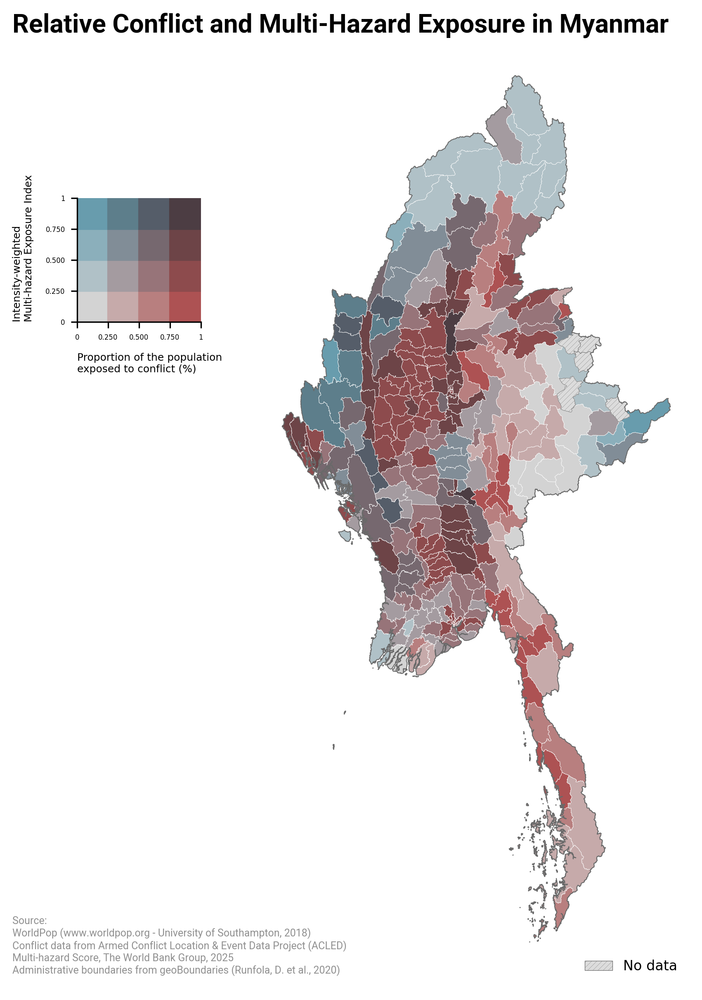

In [87]:
geoplot.plot_bivariate_choropleth( 
    var1="dfcv_conflict_exposure_relative",
    var2="mhs_intensity_weighted_exposure_relative",
    var1_bounds=[0, 1],
    var2_bounds=[0, 1],
    binning="equal_intervals",
    update_config={
        "legend_fontsize": 4, 
        "edgecolor": "white", 
        "linewidth": 0.2
    }
);

## Zoom Bivariate Choropleth to a specific region

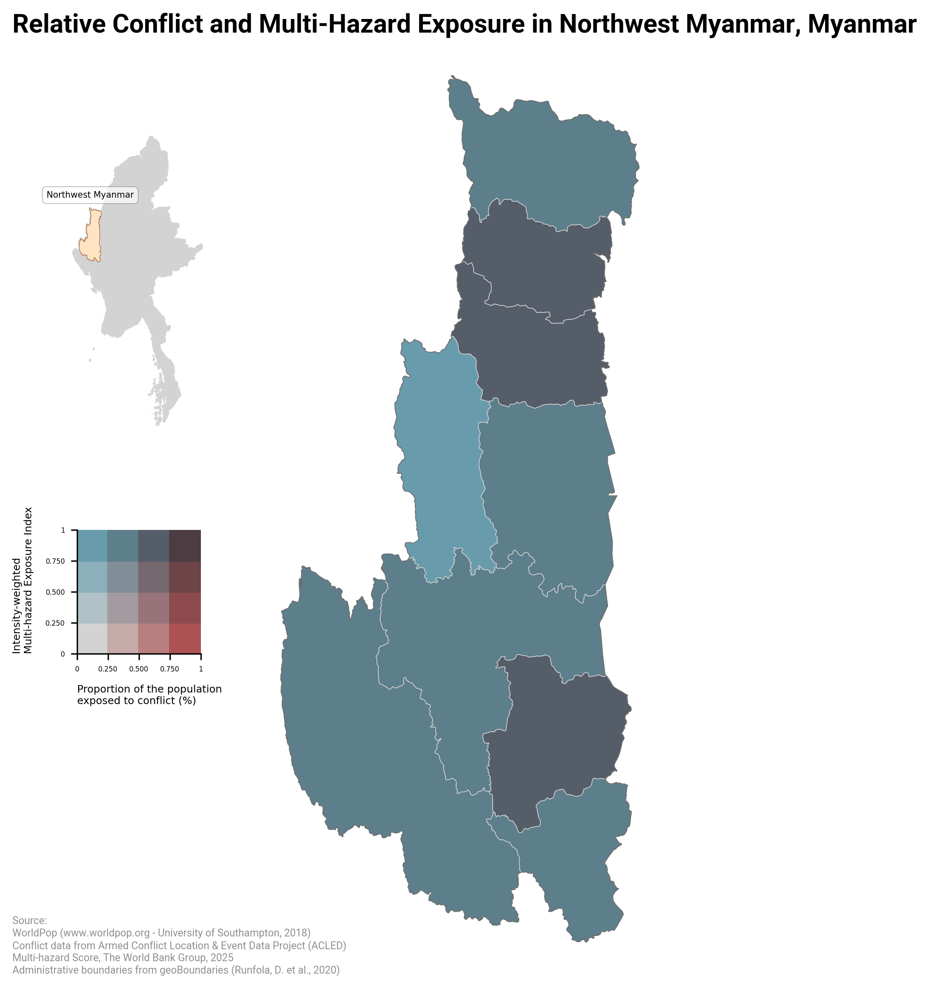

In [30]:
geoplot.plot_bivariate_choropleth( 
    var1="dfcv_conflict_exposure_relative",
    var2="mhs_intensity_weighted_exposure_relative",
    var1_bounds=[0, 1],
    var2_bounds=[0, 1],
    binning="equal_intervals",
    update_config={"legend_fontsize": 4},
    zoom_to={"BLOC": "Northwest Myanmar"},
);

## Interactive Map

In [32]:
m = geoplot.plot_folium(
    adm_level=adm_level,
    var="mhs_dfcv_conflict_exposure_relative"
)
m

In [5]:
 m.save("folium.html")